In [1]:
%pip install -U ipywidgets

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from ipywidgets import interact
from pytools import shift

In [3]:
plt.style.use('dark_background')

In [4]:
def get_diff_matrix(data_prev, data_next, weights = 1):
    a = np.stack([data_prev]*len(data_next), 0)
    b = np.stack([data_next]*len(data_prev), 0)
    axies = [i for i in range(len(b.shape))]
    axies[0], axies[1] = axies[1], axies[0]
    b = np.transpose(b, axies)
    return (a - b)*weights

def add_axi(a):
    return np.reshape(a, [*a.shape, 1])

In [5]:
class updater:
    def __init__(self, data_func, update_func, hash_len = -1):
        self.df = data_func
        self.uf = update_func
        self.t = 0
        self.__hash = [self.df()]
        self.hash_len = hash_len

    def __getitem__(self, ind:int):
        if self.t >= ind:
            return self.__hash[ind]
        while True:
            self.uf()
            self.__hash.append(self.df())
            #self.__hash = self.__hash[len(self.__hash) - 1 - self.hash_len]
            if self.t == ind:
                return self[ind]
            self.t += 1

class table_shower_updater(updater):
    def __init__(self, data_func, update_func, hash_len=-1, weights = 1):
        super().__init__(data_func, update_func, hash_len)
        self.weights = weights

    def __getitem__(self, ind):
        return get_diff_matrix(super().__getitem__(max(ind - 1, 0)), super().__getitem__(ind), self.weights)
    

In [6]:
g = lambda x:(yield (x := x - 1) if x >= 0 else 'haha')
for j in g(10):
    print(j)

9


In [7]:
def show_animation(im_data, frames = 100, **funcAnimation_args):
    fig, ax = plt.subplots()
    img = plt.imshow(im_data[0])

    def update(frame):
        img.set_data(im_data[frame])
        return img,
    ani = FuncAnimation(fig, update, frames = frames, **funcAnimation_args)
    return HTML(ani.to_jshtml())

In [8]:
def animate(data_function, update_function, frames=100, **funcAnimation_args):
    fig, ax = plt.subplots()
    img = plt.imshow(data_function())

    def update(frame):
        update_function()
        img.set_data(data_function())
        return img,
    ani = FuncAnimation(fig, update, frames=frames, **funcAnimation_args)
    return HTML(ani.to_jshtml())


def echo(func):
    if not hasattr(echo, 'outputs'):
        echo.get = dict()
    echo.get[func.__name__] = None
    def f(*args, **kwargs):
        o = echo.get[func.__name__] = func(*args, **kwargs)
        return o
    return f

In [9]:
'''
class system:
    def __init__(self, N = 10):
        pass
        self.x = np.random.sample(N) * (np.random.sample(N) > 0.5)
        self.w = np.random.uniform(-1, 1, (N, N, N)) * (1 - np.eye(N, N)) * (np.random.uniform(0, 1, (N, N, 1)) > 0.1)

    @property
    def get_w(self):
        return np.sum(self.w, -1)

    @echo
    def update(self):
        self.x += (self.x @ self.w @ self.x)*0.1
        self.x /= np.sum(self.x**2)**0.5
        return self.x

s = system()
animate(lambda:get_diff_matrix(echo.get[s.update.__name__], s.x, np.sum(s.w, -1)), s.update)
'''

def generate_connections(groups, group_complexity, group_density = 0.5, noise = 1, noise_density = 0.3, group_recurent_rate = 0.5):
    return \
    np.repeat(np.repeat((1-group_recurent_rate)*(np.random.sample([groups, groups]) < group_density) + group_recurent_rate*np.eye(groups, groups), group_complexity, 0), group_complexity, 1) * np.random.uniform(-1, 1, [group_complexity*groups]*2) + \
    noise * np.random.uniform(-1, 1, [group_complexity*groups]*2) * (np.random.sample([group_complexity*groups]*2) < noise_density) # skip connections

class system:
    def __init__(self, group_count, group_complexity, group_dens=0.5, noise_density=0.3, group_self_connections = 0.1, activity_density = 0.5, noise_level = 1.0):
        total = group_count*group_complexity
        self.x = (np.random.sample(total) < activity_density).astype(np.float32)
        self.x /= np.sum(self.x)
        self.w = generate_connections(group_count, group_complexity, group_dens, noise_density=noise_density, group_recurent_rate=group_self_connections, noise=noise_level)
    def update(self):
        self.x += 0.01*(self.w - self.w.T) @ self.x
        #self.x += 0.01*(1 - np.sum(self.x)) * (self.x/(np.sum(self.x**2)**0.5 + 1))
        self.x /= np.sum(self.x**2)**0.5
        return self.x

In [10]:
def animate_scatter(data, change_sizes = True, max_size = 5, **funcAnimation_args):
    fig, ax = plt.subplots()
    sca = plt.scatter(data['positions'][0][:,0], data['positions'][0][:,1])
    frames = len(data['positions'])
    def update(frame):
        xmin = np.min(data['positions'][frame][:, 0])
        xmax = np.max(data['positions'][frame][:, 0])
        ymin = np.min(data['positions'][frame][:, 1])
        ymax = np.max(data['positions'][frame][:, 1])
        sca.set_offsets(data['positions'][frame])
        if change_sizes:
            sca.set_sizes(max_size*data['scales'][frame]/np.max(data['scales'][frame]))
        ax.set_xlim(xmin, xmax)
        ax.set_ylim(ymin, ymax)
        return sca,
    ani = FuncAnimation(fig, update, frames=frames, cache_frame_data = False, blit = True, **funcAnimation_args)
    return HTML(ani.to_jshtml())


def graph_wave_sim(positions, activity, prev_activity, w, pushing_function, pulling_function, gravity = 0, N = 1, dt = 0.1):
    for n in range(N):
        m = get_diff_matrix(prev_activity, activity, w)
        directions = get_diff_matrix(positions, positions)
        lenghts = add_axi(np.sum(directions**2, -1)**0.5 + 0.01)
        speed = np.sum((add_axi(pushing_function(w))*directions/lenghts**2) +
                      -(add_axi(pulling_function(m))*directions/lenghts), 0)
        positions +=speed*dt
    return positions

def graph_wave(activity, w, dt = 1, pushing_force = 1, pulling_force = 1, gravity = 0, pushing_func = lambda w:1/(1 + w**2), pulling_func = lambda m:1 - 1/(1 + m**2), names = None, color = None):
    positions = np.random.uniform(-2, 2, (activity.shape[1], 2))
    h = {
        'positions':[],
        'scales':[]
    }
    graph_wave_sim(positions, activity[1], activity[0], w, lambda *args:pushing_func(*args)*pushing_force, lambda*args:pulling_func(*args)*pulling_force, N = 1000, dt = dt, gravity=gravity)
    for a, prev in zip(activity[1:], shift(activity, 1)[1:]):
        h['scales'].append(np.abs(a) + 0.1)
        h['positions'].append(np.copy(positions))
        positions = graph_wave_sim(positions, a, prev, w, lambda *args:pushing_func(*args)*pushing_force, lambda*args:pulling_func(*args)*pulling_force, N = int(10/dt), dt = dt)
    return h

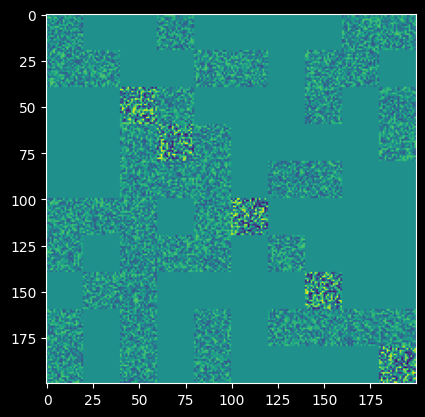

In [11]:
s = system(10, 20, noise_density=0.0, noise_level = 1.0, group_self_connections=0.5)
plt.imshow(s.w)
plt.show()

In [12]:
activity = []
for i in range(500):
    s.update()
    activity.append(np.copy(s.x))
activity = np.array(activity)

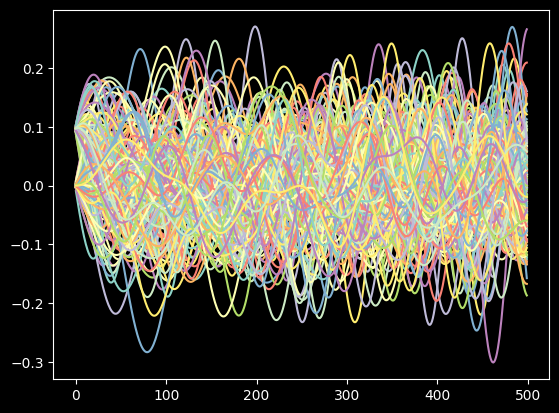

In [13]:
plt.plot(activity)
plt.show()

In [14]:
data = graph_wave(activity, s.w, 1.0, pulling_force=50, pushing_force=50)

Animation size has reached 20976656 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


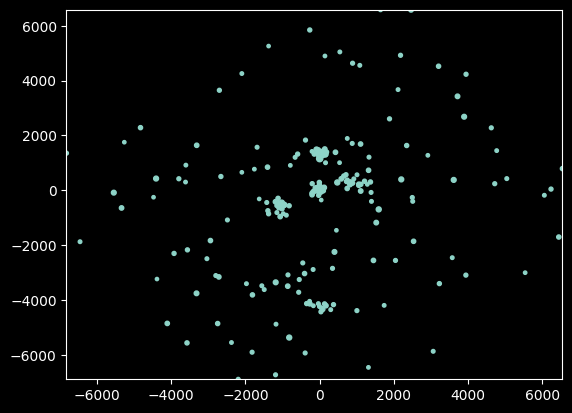

In [15]:
animate_scatter(data, max_size=20)